In [139]:
import pandas as pd
import plotly.express as px
import plotly.io as pio
import plotly.graph_objs as go
from plotly.figure_factory import create_table
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import plotly.offline as py
py.init_notebook_mode(connected=True)

In [2]:
data1 = pd.read_csv('covid.csv')
data1.head()

,Country/Region,Continent,Population,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/1M pop,WHO Region,iso_alpha
0,USA,North America,3.311981e+08,5032179,NaN,162804.0,NaN,2576668.0,NaN,2292707.0,18296.0,15194.0,492.0,63139605.0,190640.0,Americas,USA
1,Brazil,South America,2.127107e+08,2917562,NaN,98644.0,NaN,2047660.0,NaN,771258.0,8318.0,13716.0,464.0,13206188.0,62085.0,Americas,BRA
2,India,Asia,1.381345e+09,2025409,NaN,41638.0,NaN,1377384.0,NaN,606387.0,8944.0,1466.0,30.0,22149351.0,16035.0,South-EastAsia,IND
3,Russia,Europe,1.459409e+08,871894,NaN,14606.0,NaN,676357.0,NaN,180931.0,2300.0,5974.0,100.0,29716907.0,203623.0,Europe,RUS
4,South Africa,Africa,5.938157e+07,538184,NaN,9604.0,NaN,387316.0,NaN,141264.0,539.0,9063.0,162.0,3149807.0,53044.0,Africa,ZAF


In [3]:
data1.shape

(209, 17)

In [4]:
data1.size

3553

In [5]:
data1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 209 entries, 0 to 208
Data columns (total 17 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Country/Region    209 non-null    object 
 1   Continent         208 non-null    object 
 2   Population        208 non-null    float64
 3   TotalCases        209 non-null    int64  
 4   NewCases          4 non-null      float64
 5   TotalDeaths       188 non-null    float64
 6   NewDeaths         3 non-null      float64
 7   TotalRecovered    205 non-null    float64
 8   NewRecovered      3 non-null      float64
 9   ActiveCases       205 non-null    float64
 10  Serious,Critical  122 non-null    float64
 11  Tot Cases/1M pop  208 non-null    float64
 12  Deaths/1M pop     187 non-null    float64
 13  TotalTests        191 non-null    float64
 14  Tests/1M pop      191 non-null    float64
 15  WHO Region        184 non-null    object 
 16  iso_alpha         209 non-null    object 
dt

In [6]:
data2 = pd.read_csv('covid_grouped.csv')
data2.head()

,Date,Country/Region,Confirmed,Deaths,Recovered,Active,New cases,New deaths,New recovered,WHO Region,iso_alpha
0,2020-01-22,Afghanistan,0,0,0,0,0,0,0,Eastern Mediterranean,AFG
1,2020-01-22,Albania,0,0,0,0,0,0,0,Europe,ALB
2,2020-01-22,Algeria,0,0,0,0,0,0,0,Africa,DZA
3,2020-01-22,Andorra,0,0,0,0,0,0,0,Europe,AND
4,2020-01-22,Angola,0,0,0,0,0,0,0,Africa,AGO


In [7]:
print(data2.shape)
print(data2.size)

(35156, 11)
386716


In [8]:
data2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35156 entries, 0 to 35155
Data columns (total 11 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Date            35156 non-null  object
 1   Country/Region  35156 non-null  object
 2   Confirmed       35156 non-null  int64 
 3   Deaths          35156 non-null  int64 
 4   Recovered       35156 non-null  int64 
 5   Active          35156 non-null  int64 
 6   New cases       35156 non-null  int64 
 7   New deaths      35156 non-null  int64 
 8   New recovered   35156 non-null  int64 
 9   WHO Region      35156 non-null  object
 10  iso_alpha       35156 non-null  object
dtypes: int64(7), object(4)
memory usage: 3.0+ MB


In [9]:
data1.columns

Index(['Country/Region', 'Continent', 'Population', 'TotalCases', 'NewCases',
       'TotalDeaths', 'NewDeaths', 'TotalRecovered', 'NewRecovered',
       'ActiveCases', 'Serious,Critical', 'Tot Cases/1M pop', 'Deaths/1M pop',
       'TotalTests', 'Tests/1M pop', 'WHO Region', 'iso_alpha'],
      dtype='object')

In [10]:
data1.drop(['NewCases', 'NewDeaths', 'NewRecovered'], axis=1, inplace=True)
data1.sample(5)

,Country/Region,Continent,Population,TotalCases,TotalDeaths,TotalRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/1M pop,WHO Region,iso_alpha
89,Finland,Europe,5541604.0,7532,331.0,6980.0,221.0,NaN,1359.0,60.0,389500.0,70287.0,Europe,FIN
144,Togo,Africa,8296582.0,1012,22.0,697.0,293.0,2.0,122.0,3.0,45767.0,5516.0,Africa,TGO
132,Tunisia,Africa,11830801.0,1642,51.0,1241.0,350.0,9.0,139.0,4.0,100298.0,8478.0,EasternMediterranean,TUN
103,Hungary,Europe,9657785.0,4597,600.0,3463.0,534.0,8.0,476.0,62.0,352546.0,36504.0,Europe,HUN
173,Aruba,North America,106812.0,263,3.0,114.0,146.0,NaN,2462.0,28.0,14047.0,131511.0,NaN,ABW


In [11]:
colorscale = [[0, '#4d004c'], [.5, '#f2e5ff'], [1, '#ffffff']]
table = create_table(data1.head(15), colorscale=colorscale)
py.iplot(table)

In [12]:
px.bar(data1.head(15), x = 'Country/Region', y = 'TotalCases',
      color = 'TotalCases',  hover_data = ['Country/Region', 'Continent'])

In [13]:
px.bar(data1.head(15), x='Country/Region', y='TotalCases', color='TotalDeaths', height=500,
      hover_data=['Country/Region', 'Continent'])

In [14]:
px.bar(data1.head(15), x='Country/Region', y='TotalCases', color='TotalRecovered', height=500,
      hover_data=['Country/Region', 'Continent'])

In [15]:
px.bar(data1.head(15), x='Country/Region', y='TotalCases', color='TotalTests', height=500,
      hover_data=['Country/Region', 'Continent'])

In [16]:
px.bar(data1.head(15), x='TotalTests', y='Country/Region', color='TotalTests',
      hover_data=['Country/Region', 'Continent'], orientation='h')

In [17]:
px.bar(data1.head(15), x='TotalTests', y='Continent', color='TotalTests', orientation='h',
      hover_data=['Country/Region', 'Continent'])

In [18]:
px.scatter(data1, x='Continent', y='TotalCases', hover_data=['Country/Region', 'Continent'],
          color='TotalCases', size_max=80, size='TotalCases')

In [19]:
px.scatter(data1, x='Continent', y='TotalCases', hover_data=['Country/Region', 'Continent'],
          color='TotalCases', size_max=80, size='TotalCases', log_y=True)

In [20]:
px.scatter(data1.head(54), x='Continent', y='TotalTests', hover_data=['Country/Region', 'Continent'],
          color='TotalTests', size_max=80, size='TotalCases')

In [21]:
px.scatter(data1.head(50), x='Continent', y='TotalTests', hover_data=['Country/Region', 'Continent'],
          color='TotalTests', size_max=80, size='TotalCases', log_y=True)

In [22]:
px.scatter(data1.head(100), x='Country/Region', y='TotalCases', hover_data=['Country/Region', 'Continent'],
          color='TotalCases', size_max=80, size='TotalCases')

In [23]:
px.scatter(data1, x='Country/Region', y='TotalCases', hover_data=['Country/Region', 'Continent'],
          color='TotalDeaths', size_max=80, size='TotalCases')

In [24]:
px.scatter(data1.head(30), x='Country/Region', y='TotalCases', hover_data=['Country/Region', 'Continent'],
          color='Country/Region', size_max=80, size='TotalCases', log_y=True)

In [25]:
px.scatter(data1.head(10), x='Country/Region', y='TotalDeaths', hover_data=['Country/Region', 'Continent'],
          color='Country/Region', size_max=80, size='TotalDeaths')

In [26]:
px.scatter(data1.head(30), x='Country/Region', y= 'Tests/1M pop',  
           hover_data=['Country/Region', 'Continent'], 
           color='Country/Region', size= 'Tests/1M pop', size_max=80)

In [27]:
px.scatter(data1.head(30), x='Country/Region', y= 'Tests/1M pop', 
		hover_data=['Country/Region', 'Continent'], 
		color='Tests/1M pop', size= 'Tests/1M pop', size_max=80)

In [28]:
data2.columns

Index(['Date', 'Country/Region', 'Confirmed', 'Deaths', 'Recovered', 'Active',
       'New cases', 'New deaths', 'New recovered', 'WHO Region', 'iso_alpha'],
      dtype='object')

In [29]:
px.bar(data2, x='Date', y='Confirmed', color='Confirmed', hover_data=['Confirmed', 'Date','Country/Region'],
      height=400)

In [85]:
filtered_data = data2[data2['Country/Region'].str.contains('India|Pakistan')]
px.bar(filtered_data, x='Date', y='Confirmed', color='Confirmed', hover_data=['Confirmed', 'Date','Country/Region'],
      height=400, log_y=True)

In [86]:
filtered_data = data2[data2['Country/Region'].str.contains('India')]
px.bar(filtered_data, x='Date', y='Deaths', color='Deaths', hover_data=['Confirmed', 'Date','Country/Region','Deaths'],
      height=400, log_y=True)

In [88]:
filtered_data = data2[data2['Country/Region'].str.contains('India')]
px.bar(filtered_data, x='Date', y='Recovered', color='Recovered', hover_data=['Confirmed', 'Date','Country/Region', 'Recovered'],
      height=400, log_y=True)`

In [89]:
filtered_data = data2[data2['Country/Region'].str.contains('India')]
px.line(filtered_data, x='Date', y='Recovered')

In [90]:
px.line(filtered_data, x='Date', y='Deaths')

In [91]:
px.line(filtered_data, x='Date', y='Confirmed')

In [93]:
px.line(filtered_data, x='Date', y='New cases')

In [96]:
px.scatter(filtered_data, x='Confirmed', y='Deaths')

In [127]:
px.choropleth(data2, locations='iso_alpha', color='Confirmed', hover_name='Country/Region',
             color_continuous_scale='magenta', animation_frame='Date')

In [128]:
px.choropleth(data2, locations='iso_alpha', color='Deaths', hover_name='Country/Region',
             color_continuous_scale='magenta', animation_frame='Date')

In [133]:
px.choropleth(data2, locations='iso_alpha', color='Recovered', hover_name='Country/Region',
             color_continuous_scale='bugn', projection='natural earth', animation_frame='Date')

In [134]:
px.bar(data2, x="WHO Region", y="Confirmed", color="WHO Region",  
       animation_frame="Date", hover_name="Country/Region")

In [136]:
data3 = pd.read_csv('coviddeath.csv')
data3.head()

,Data as of,Start Week,End Week,State,Condition Group,Condition,ICD10_codes,Age Group,Number of COVID-19 Deaths,Flag
0,08/30/2020,02/01/2020,08/29/2020,US,Respiratory diseases,Influenza and pneumonia,J09-J18,0-24,122.0,NaN
1,08/30/2020,02/01/2020,08/29/2020,US,Respiratory diseases,Influenza and pneumonia,J09-J18,25-34,596.0,NaN
2,08/30/2020,02/01/2020,08/29/2020,US,Respiratory diseases,Influenza and pneumonia,J09-J18,35-44,1521.0,NaN
3,08/30/2020,02/01/2020,08/29/2020,US,Respiratory diseases,Influenza and pneumonia,J09-J18,45-54,4186.0,NaN
4,08/30/2020,02/01/2020,08/29/2020,US,Respiratory diseases,Influenza and pneumonia,J09-J18,55-64,10014.0,NaN


In [137]:
data3.tail()

,Data as of,Start Week,End Week,State,Condition Group,Condition,ICD10_codes,Age Group,Number of COVID-19 Deaths,Flag
12255,08/30/2020,02/01/2020,08/29/2020,YC,Coronavirus Disease 2019,COVID-19,U071,65-74,5024.0,NaN
12256,08/30/2020,02/01/2020,08/29/2020,YC,Coronavirus Disease 2019,COVID-19,U071,75-84,5381.0,NaN
12257,08/30/2020,02/01/2020,08/29/2020,YC,Coronavirus Disease 2019,COVID-19,U071,85+,4841.0,NaN
12258,08/30/2020,02/01/2020,08/29/2020,YC,Coronavirus Disease 2019,COVID-19,U071,Not stated,NaN,Counts less than 10 suppressed.
12259,08/30/2020,02/01/2020,08/29/2020,YC,Coronavirus Disease 2019,COVID-19,U071,All ages,20628.0,NaN


In [138]:
data3.groupby(['Condition']).count()

,Data as of,Start Week,End Week,State,Condition Group,ICD10_codes,Age Group,Number of COVID-19 Deaths,Flag
Condition,,,,,,,,,
Adult respiratory distress syndrome,540,540,540,540,540,540,540,272,268
All other conditions and causes (residual),540,540,540,540,540,540,540,363,177
Alzheimer disease,530,530,530,530,530,530,530,144,386
COVID-19,540,540,540,540,540,540,540,377,163
Cardiac arrest,520,520,520,520,520,520,520,219,301
Cardiac arrhythmia,540,540,540,540,540,540,540,192,348
Cerebrovascular diseases,530,530,530,530,530,530,530,187,343
Chronic lower respiratory diseases,540,540,540,540,540,540,540,229,311
Diabetes,540,540,540,540,540,540,540,276,264


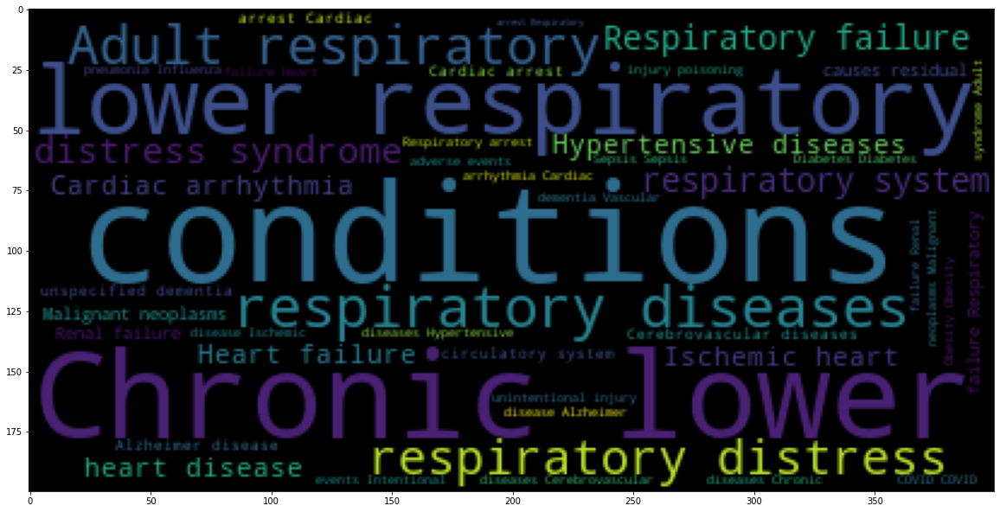

In [143]:
sentences = data3['Condition'].tolist()
sentences_as_a_string = ' '.join(sentences)

plt.figure(figsize=(20,20))
plt.imshow(WordCloud().generate(sentences_as_a_string))

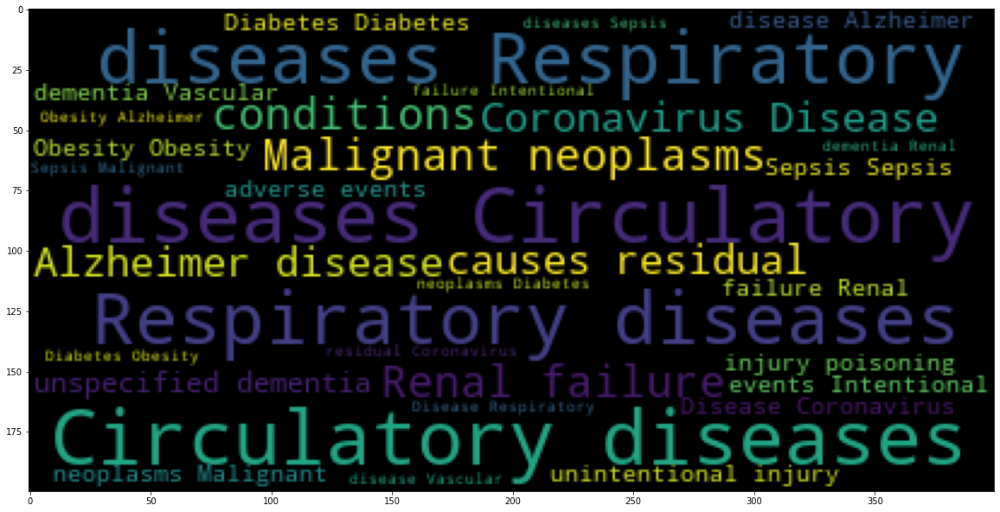

In [144]:
column2_tolist = data3['Condition Group'].tolist()
column_to_string = ' '.join(column2_tolist)

plt.figure(figsize=(20,20))
plt.imshow(WordCloud().generate(column_to_string))